In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os
import tensorflow as tf

from tensorflow.keras.preprocessing import image_dataset_from_directory

In [ ]:
data_dir = "/content/gdrive/My Drive/thesis/new_dataset/"
training_path = os.path.join(data_dir, 'train')
test_path = os.path.join(data_dir, 'test')

In [ ]:
BATCH_SIZE = 32
IMG_SIZE = (160, 160)

In [ ]:
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(training_path, batch_size=BATCH_SIZE, image_size=IMG_SIZE)

Found 18957 files belonging to 2 classes.


In [ ]:
validation_dataset = tf.keras.preprocessing.image_dataset_from_directory(test_path, batch_size=BATCH_SIZE, image_size=IMG_SIZE)

Found 2497 files belonging to 2 classes.


In [ ]:
class_names = train_dataset.class_names
print(class_names)

['esc', 'no_esc']


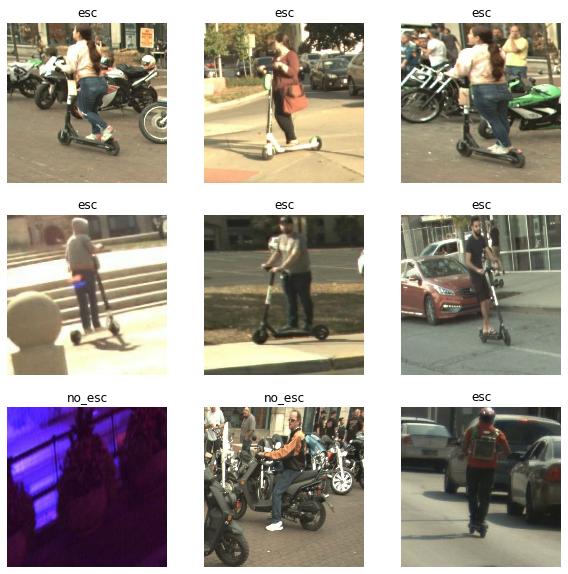

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

separating the test dataset in batches from validation dataset

In [ ]:
val_batches = tf.data.experimental.cardinality(validation_dataset)
test_dataset = validation_dataset.take(val_batches // 5)
validation_dataset = validation_dataset.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % tf.data.experimental.cardinality(validation_dataset))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_dataset))

Number of validation batches: 64
Number of test batches: 15


configure the dastaset for performance

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_dataset.prefetch(buffer_size=AUTOTUNE)

using data augmentation

In [ ]:
# RandomCrop layer
# RandomFlip layer
# RandomTranslation layer
# RandomRotation layer
# RandomZoom layer
# RandomHeight layer
# RandomWidth layer

In [ ]:
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.1),
  tf.keras.layers.experimental.preprocessing.RandomZoom(0.1),
  # tf.keras.layers.experimental.preprocessing.RandomTranslation(height_factor=(-0.2, 0.3), width_factor=(-0.2, 0.3))
])

In [ ]:
for image, _ in train_dataset.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

rescale pixel values

In [ ]:
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

In [ ]:
# rescale = tf.keras.layers.experimental.preprocessing.Rescaling(1./127.5, offset= -1)

Create the base model from the pre-trained convnets

In [ ]:
# Create the base model from the pre-trained model MobileNet V2
IMG_SHAPE = IMG_SIZE + (3,)
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

9412608/9406464 [==============================] - 0s 0us/step


In [ ]:
image_batch, label_batch = next(iter(train_dataset))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 5, 5, 1280)


**Feature Extraction**

In [ ]:
base_model.trainable = False

base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 80, 80, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 80, 80, 32)   128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 80, 80, 32)   0           bn_Conv1[0][0]                   
_______________________________________________________________________________

Add a classification head

In [ ]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [ ]:
# prediction_layer = tf.keras.layers.Dense(1)
prediction_layer = tf.keras.layers.Dense(1, activation='sigmoid')
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 1)


In [ ]:
inputs = tf.keras.Input(shape=(160, 160, 3))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.3)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs) 

Compile the model

In [ ]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(),
              metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 160, 160, 3)       0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 160, 160, 3)       0         
_________________________________________________________________
tf.math.subtract (TFOpLambda (None, 160, 160, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_160 (Functi (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0     

In [ ]:
len(model.trainable_variables)

2

In [ ]:
initial_epochs = 10

loss0, accuracy0 = model.evaluate(validation_dataset)

64/64 [==============================] - 301s 3s/step - loss: 0.7728 - accuracy: 0.5488


In [ ]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 0.77
initial accuracy: 0.55


In [ ]:
history = model.fit(train_dataset,
                    epochs=initial_epochs,
                    validation_data=validation_dataset)

Epoch 1/10
593/593 [==============================] - 2156s 4s/step - loss: 0.6495 - accuracy: 0.6482 - val_loss: 0.4888 - val_accuracy: 0.7556
Epoch 2/10
593/593 [==============================] - 42s 70ms/step - loss: 0.4925 - accuracy: 0.7634 - val_loss: 0.4376 - val_accuracy: 0.7853
Epoch 3/10
593/593 [==============================] - 44s 74ms/step - loss: 0.4456 - accuracy: 0.7978 - val_loss: 0.4014 - val_accuracy: 0.8071
Epoch 4/10
593/593 [==============================] - 44s 73ms/step - loss: 0.4094 - accuracy: 0.8145 - val_loss: 0.3808 - val_accuracy: 0.8235
Epoch 5/10
593/593 [==============================] - 43s 72ms/step - loss: 0.3964 - accuracy: 0.8233 - val_loss: 0.3627 - val_accuracy: 0.8290
Epoch 6/10
593/593 [==============================] - 44s 73ms/step - loss: 0.3874 - accuracy: 0.8276 - val_loss: 0.3516 - val_accuracy: 0.8354
Epoch 7/10
593/593 [==============================] - 42s 71ms/step - loss: 0.3720 - accuracy: 0.8369 - val_loss: 0.3439 - val_accuracy:

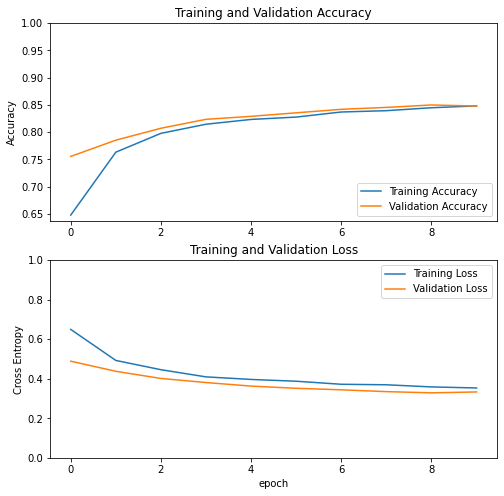

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
# serialize model to JSON
model_json = model.to_json()
with open("/content/gdrive/My Drive/thesis/thesis_model_4_1_frozen.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("/content/gdrive/My Drive/thesis/thesis_model_4_1_frozen.h5")
print("Saved model to disk")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Saved model to disk


**Fine tuning the model**

In [ ]:
base_model.trainable = True

In [ ]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 130

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  154


In [ ]:
# from tensorflow.keras.callbacks import EarlyStopping
# es = EarlyStopping(monitor='val_loss', mode='min', patience=3)

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 160, 160, 3)       0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 160, 160, 3)       0         
_________________________________________________________________
tf.math.subtract (TFOpLambda (None, 160, 160, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_160 (Functi (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0     

In [ ]:
len(model.trainable_variables)

26

In [ ]:
fine_tune_epochs = 15
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_dataset,
                        #  callbacks=[es]
                         )

Epoch 10/25
593/593 [==============================] - 49s 75ms/step - loss: 0.3013 - accuracy: 0.8711 - val_loss: 0.2308 - val_accuracy: 0.9063
Epoch 11/25
593/593 [==============================] - 46s 76ms/step - loss: 0.2373 - accuracy: 0.9011 - val_loss: 0.2096 - val_accuracy: 0.9207
Epoch 12/25
593/593 [==============================] - 45s 75ms/step - loss: 0.2068 - accuracy: 0.9167 - val_loss: 0.1942 - val_accuracy: 0.9207
Epoch 13/25
593/593 [==============================] - 45s 74ms/step - loss: 0.1798 - accuracy: 0.9282 - val_loss: 0.1897 - val_accuracy: 0.9271
Epoch 14/25
593/593 [==============================] - 47s 78ms/step - loss: 0.1644 - accuracy: 0.9356 - val_loss: 0.1785 - val_accuracy: 0.9316
Epoch 15/25
593/593 [==============================] - 47s 78ms/step - loss: 0.1497 - accuracy: 0.9400 - val_loss: 0.2262 - val_accuracy: 0.9147
Epoch 16/25
593/593 [==============================] - 46s 77ms/step - loss: 0.1366 - accuracy: 0.9488 - val_loss: 0.1867 - val_ac

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

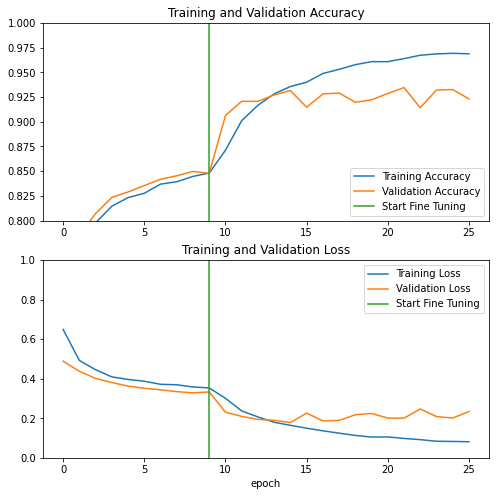

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
# serialize model to JSON
model_json = model.to_json()
with open("/content/gdrive/My Drive/thesis/thesis_model_4_1_fine.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("/content/gdrive/My Drive/thesis/thesis_model_4_1_fine.h5")
print("Saved model to disk")

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Saved model to disk


**Evaluation and Prediction**

In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print('Test accuracy :', accuracy)

15/15 [==============================] - 1s 65ms/step - loss: 0.3069 - accuracy: 0.8646
Test accuracy : 0.8645833134651184


Predictions:
 [0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1]
Labels:
 [0 0 0 1 1 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 1]


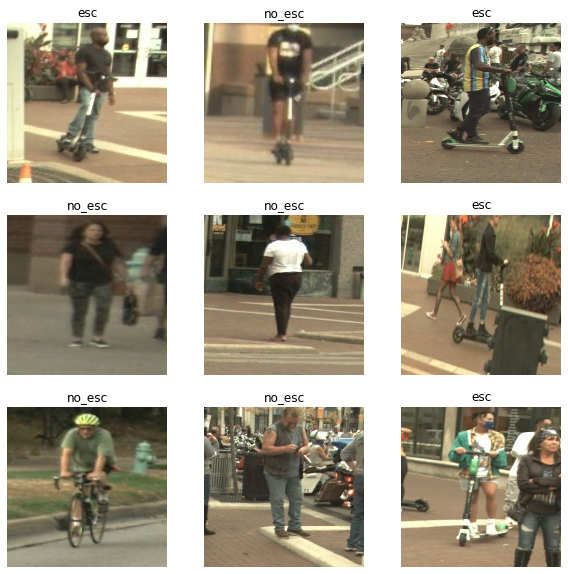

In [ ]:
#Retrieve a batch of images from the test set
image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = model.predict_on_batch(image_batch).flatten()

# Apply a sigmoid since our model returns logits
predictions = tf.nn.sigmoid(predictions)
predictions = tf.where(predictions < 0.5, 0, 1)

print('Predictions:\n', predictions.numpy())
print('Labels:\n', label_batch)

plt.figure(figsize=(10, 10))
for i in range(9):
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[predictions[i]])
  plt.axis("off")

In [ ]:
# serialize model to JSON
model_json = model.to_json()
with open("/content/gdrive/My Drive/thesis/ph3_tl_2_ft_1.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("/content/gdrive/My Drive/thesis/ph3_tl_2_ft_1.h5")
print("Saved model to disk")

Saved model to disk


In [ ]:
# LOADING THE SAVED MODEL

from tensorflow.keras.models import model_from_json

# load json and create model
json_file = open("/content/gdrive/My Drive/thesis/thesis_model_4_1.json", 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
# load weights into new model
model.load_weights("/content/gdrive/My Drive/thesis/thesis_model_4_1.h5")
print("Loaded model from disk")

# evaluate loaded model on test data
base_learning_rate = 0.0001
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

Loaded model from disk


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print('Test accuracy :', accuracy)

15/15 [==============================] - 1s 67ms/step - loss: 0.1569 - accuracy: 0.9375
Test accuracy : 0.9375


In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.metrics import roc_curve, roc_auc_score, auc

In [ ]:
def get_model_metrics(reality, predictions):
    print('\nConfusion Matrix')
    print(confusion_matrix(reality, predictions))
    print('\nClassification Report')
    target_names = ['esc', 'no-esc']
    print(classification_report(reality, predictions, target_names=target_names))

In [ ]:
def draw_ROC(original_labels, prediction_scores):
  fpr, tpr, _ = roc_curve(original_labels, prediction_scores)
  roc_auc = auc(fpr, tpr)
  print("ROC-AUC Score: ", roc_auc)
  plt.figure()
  lw = 2
  plt.plot(fpr, tpr, color='darkorange',
  lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
  plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.05])
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('Receiver operating characteristic example')
  plt.legend(loc="lower right")
  plt.show()

In [ ]:
from tensorflow import keras

In [ ]:
test_path = '/content/gdrive/My Drive/thesis/new_dataset/test'
os.listdir(test_path)

['no_esc', 'esc']

In [ ]:
len(os.listdir(os.path.join(test_path, 'no_esc')))

1228

In [ ]:
len(os.listdir(os.path.join(test_path, 'esc')))

1269

In [ ]:
prediction_scores = []

In [ ]:
for direc in os.listdir(test_path):
  dir_path = os.path.join(test_path, direc)

  filenames = os.listdir(dir_path)
  for filename in filenames:
    img_file_path = os.path.join(dir_path, filename)
    img = keras.preprocessing.image.load_img(img_file_path, target_size=IMG_SIZE)
    img_array = keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0) # Create a batch
    pred = model.predict(img_array)
    # score = tf.nn.sigmoid(pred.flatten()).numpy()
    score = pred.flatten()#.numpy()
    prediction_scores.append(score[0])

In [ ]:
len(prediction_scores)

2497

In [ ]:
max(prediction_scores)

1.0

In [ ]:
original_labels = [1]*1228 + [0]*1269 
# original_labels = [0]*1269 + [1]*1228
# original_labels = [0]*1228 + [1]*1269
len(original_labels)

2497

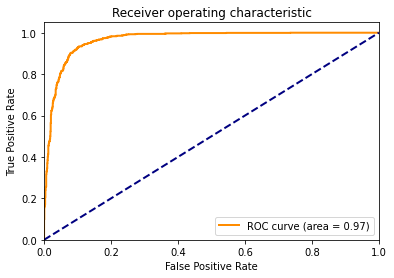

In [ ]:
fpr, tpr, _ = roc_curve(original_labels, prediction_scores)
roc_auc = auc(fpr, tpr)
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='darkorange',
lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

In [ ]:
def get_preds(conf):
  predictions = []
  for pred in prediction_scores:
    # if closer to 0, it is an escooter rider
    # if 1, not an esc rider
    if pred <= 1-conf: l = 0
    if pred > 1-conf: l = 1
    predictions.append(l)
  return predictions

In [ ]:
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

Populating the interactive namespace from numpy and matplotlib


In [ ]:
conf = 0.50
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
# draw_ROC(original_labels, predictions)


Confusion Matrix
[[1049  220]
 [  39 1189]]

Classification Report
              precision    recall  f1-score   support

         esc       0.96      0.83      0.89      1269
      no-esc       0.84      0.97      0.90      1228

    accuracy                           0.90      2497
   macro avg       0.90      0.90      0.90      2497
weighted avg       0.90      0.90      0.90      2497



Predicted as:  0  | Originally:  1


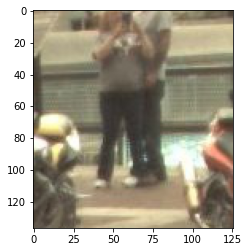

---

Predicted as:  0  | Originally:  1


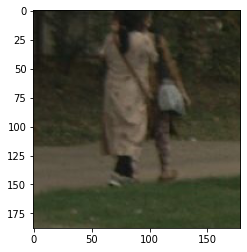

---

Predicted as:  0  | Originally:  1


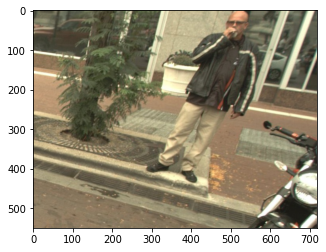

---

Predicted as:  0  | Originally:  1


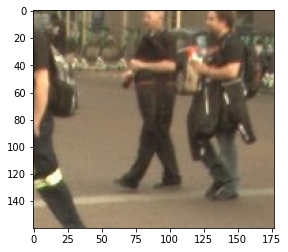

---

Predicted as:  0  | Originally:  1


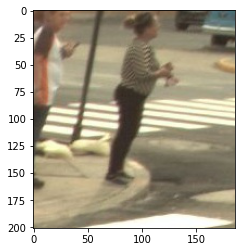

---

Predicted as:  0  | Originally:  1


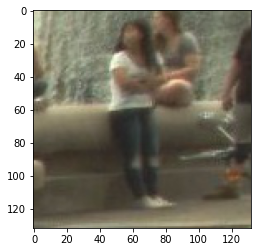

---

Predicted as:  0  | Originally:  1


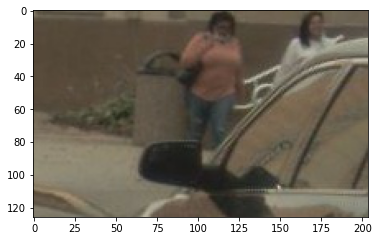

---

Predicted as:  0  | Originally:  1


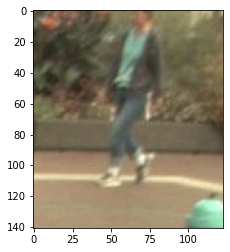

---

Predicted as:  0  | Originally:  1


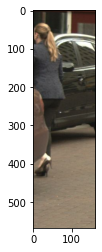

---

Predicted as:  0  | Originally:  1


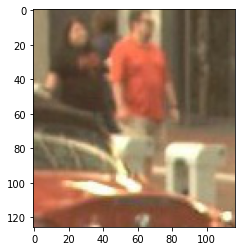

---

Predicted as:  0  | Originally:  1


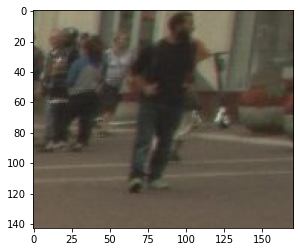

---

Predicted as:  0  | Originally:  1


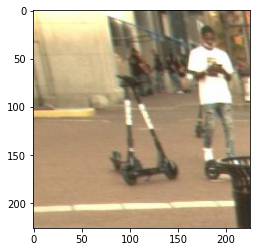

---

Predicted as:  0  | Originally:  1


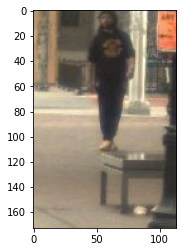

---

Predicted as:  0  | Originally:  1


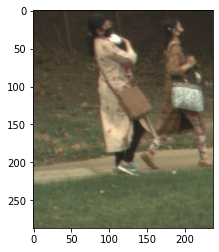

---

Predicted as:  0  | Originally:  1


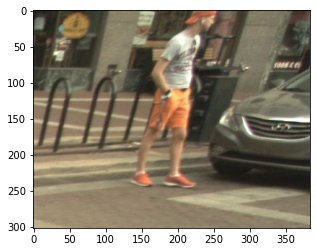

---

Predicted as:  0  | Originally:  1


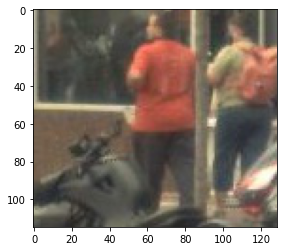

---

Predicted as:  0  | Originally:  1


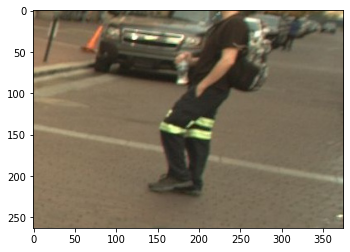

---

Predicted as:  0  | Originally:  1


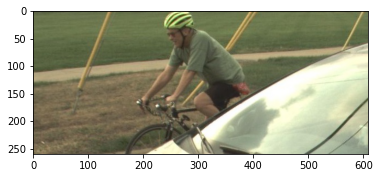

---

Predicted as:  0  | Originally:  1


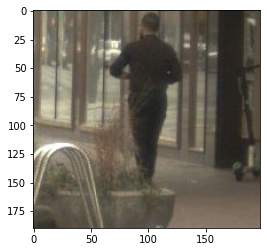

---

Predicted as:  0  | Originally:  1


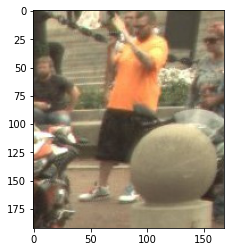

---

Predicted as:  0  | Originally:  1


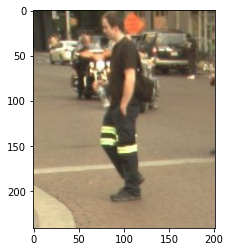

---

Predicted as:  0  | Originally:  1


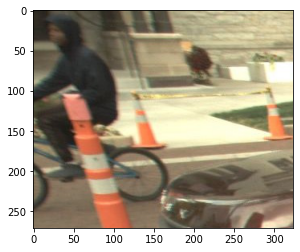

---

Predicted as:  0  | Originally:  1


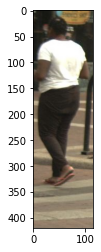

---

Predicted as:  0  | Originally:  1


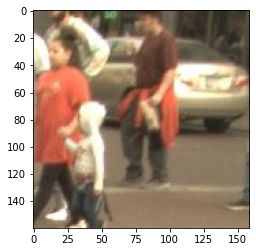

---

Predicted as:  0  | Originally:  1


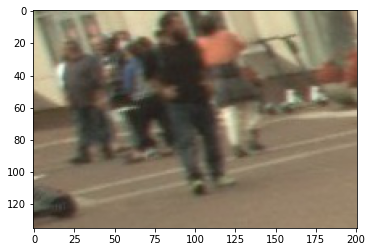

---

Predicted as:  0  | Originally:  1


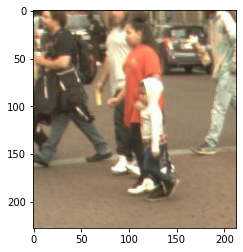

---

Predicted as:  0  | Originally:  1


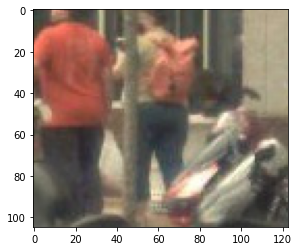

---

Predicted as:  0  | Originally:  1


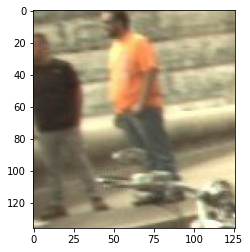

---

Predicted as:  0  | Originally:  1


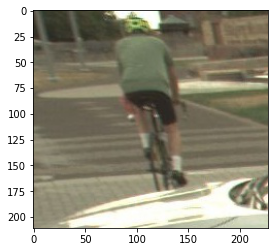

---

Predicted as:  0  | Originally:  1


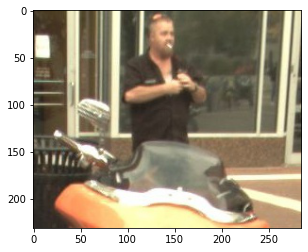

---

Predicted as:  0  | Originally:  1


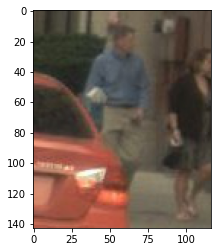

---

Predicted as:  0  | Originally:  1


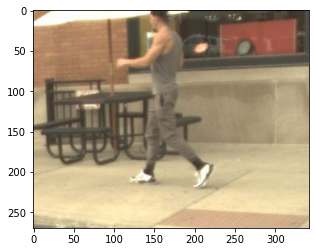

---

Predicted as:  0  | Originally:  1


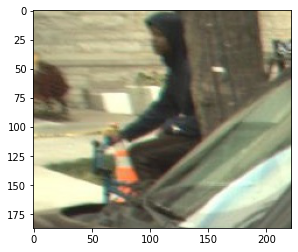

---

Predicted as:  0  | Originally:  1


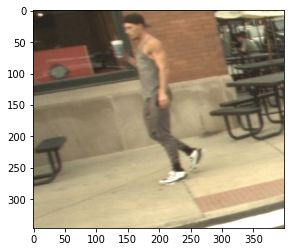

---

Predicted as:  0  | Originally:  1


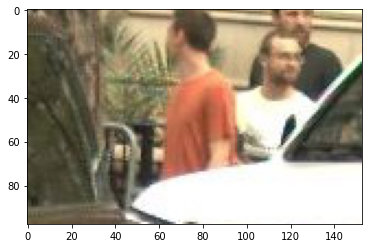

---

Predicted as:  0  | Originally:  1


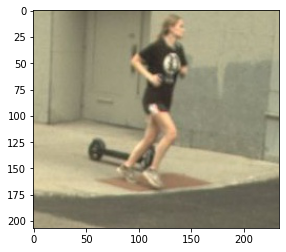

---

Predicted as:  0  | Originally:  1


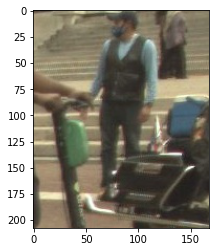

---

Predicted as:  0  | Originally:  1


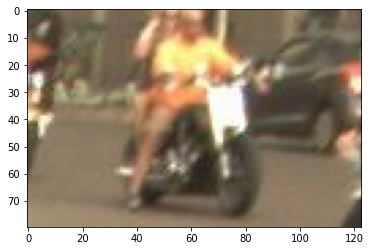

---

Predicted as:  0  | Originally:  1


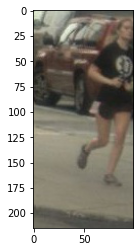

---

Predicted as:  0  | Originally:  1


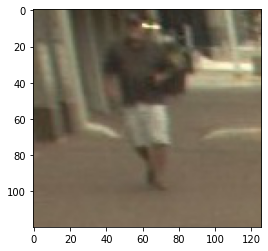

---

Predicted as:  0  | Originally:  1


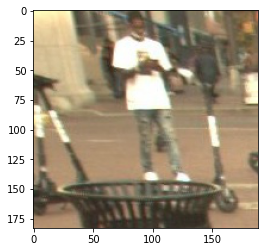

---

Predicted as:  0  | Originally:  1


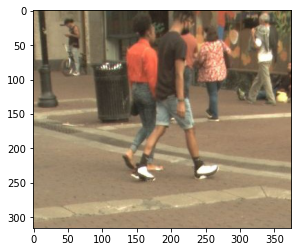

---

Predicted as:  0  | Originally:  1


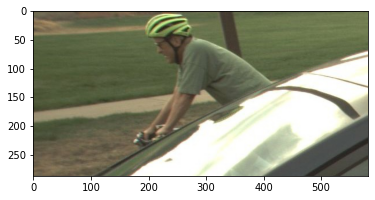

---

Predicted as:  0  | Originally:  1


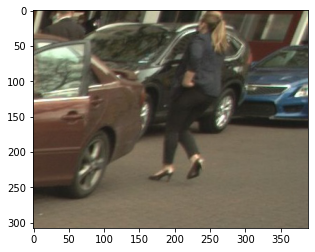

---

Predicted as:  0  | Originally:  1


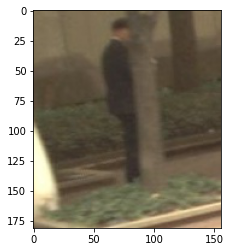

---

Predicted as:  0  | Originally:  1


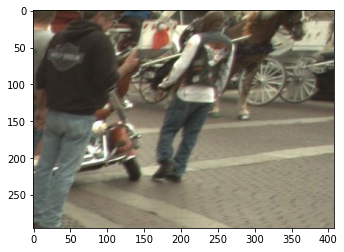

---

Predicted as:  0  | Originally:  1


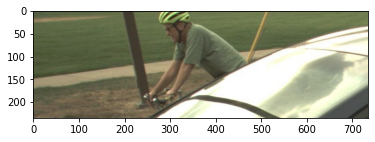

---

Predicted as:  0  | Originally:  1


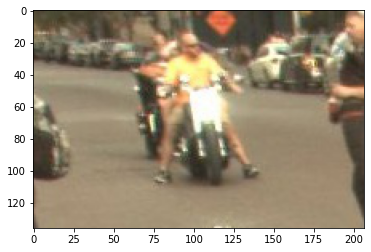

---

Predicted as:  0  | Originally:  1


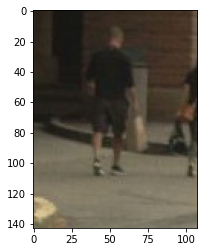

---

Predicted as:  0  | Originally:  1


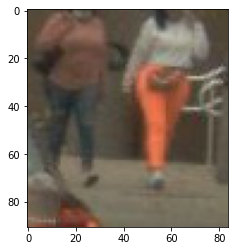

---

Predicted as:  0  | Originally:  1


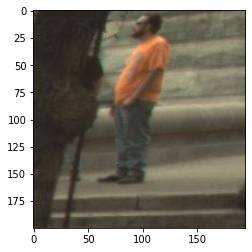

---

Predicted as:  0  | Originally:  1


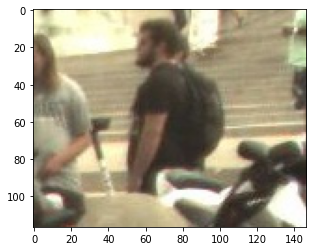

---

Predicted as:  0  | Originally:  1


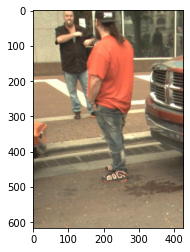

---

Predicted as:  0  | Originally:  1


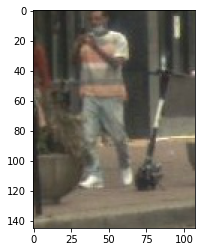

---

Predicted as:  0  | Originally:  1


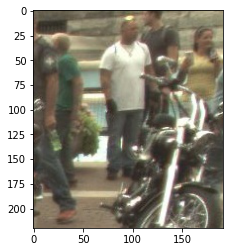

---

Predicted as:  0  | Originally:  1


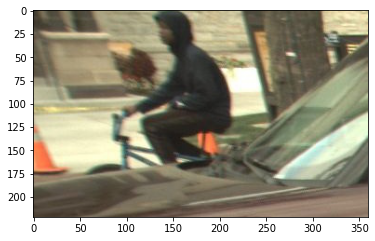

---

Predicted as:  0  | Originally:  1


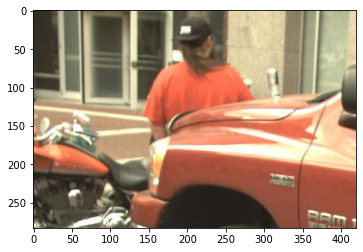

---

Predicted as:  0  | Originally:  1


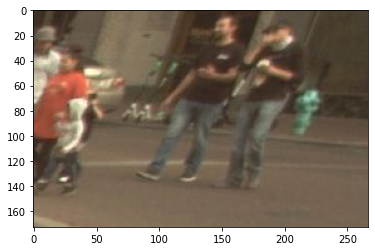

---

Predicted as:  0  | Originally:  1


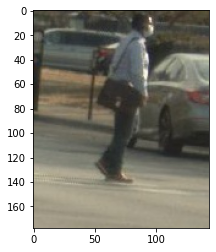

---

Predicted as:  0  | Originally:  1


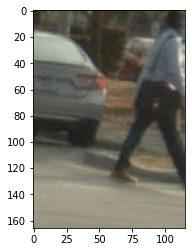

---

Predicted as:  0  | Originally:  1


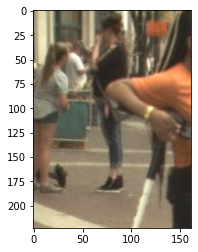

---

Predicted as:  0  | Originally:  1


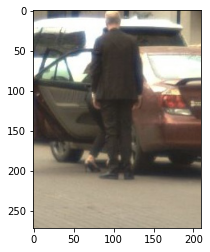

---

Predicted as:  0  | Originally:  1


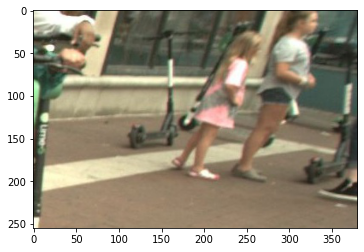

---

Predicted as:  0  | Originally:  1


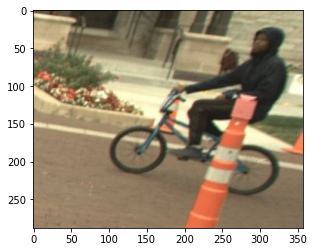

---

Predicted as:  0  | Originally:  1


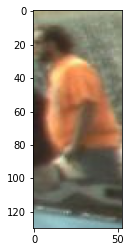

---

Predicted as:  0  | Originally:  1


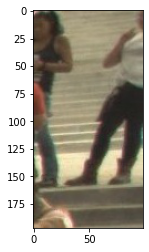

---

Predicted as:  0  | Originally:  1


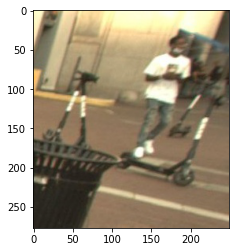

---

Predicted as:  0  | Originally:  1


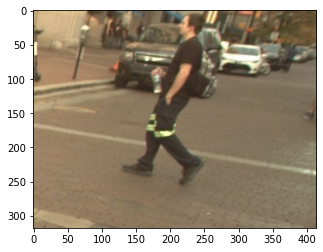

---

Predicted as:  0  | Originally:  1


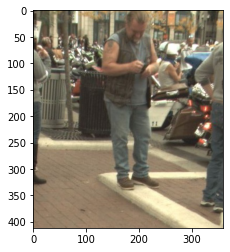

---

Predicted as:  0  | Originally:  1


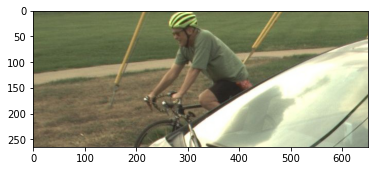

---

Predicted as:  0  | Originally:  1


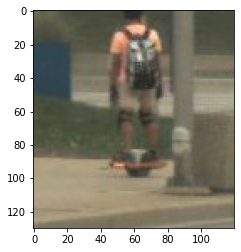

---

Predicted as:  1  | Originally:  0


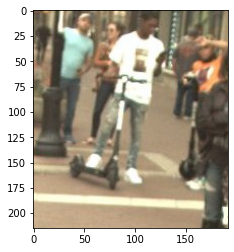

---

Predicted as:  1  | Originally:  0


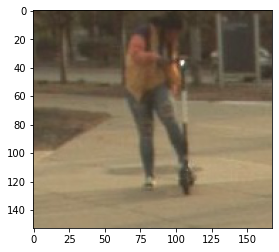

---

Predicted as:  1  | Originally:  0


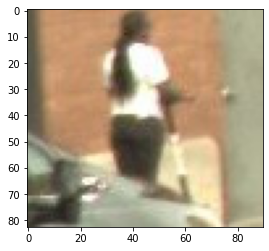

---

Predicted as:  1  | Originally:  0


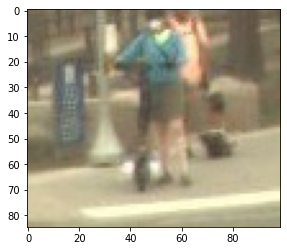

---

Predicted as:  1  | Originally:  0


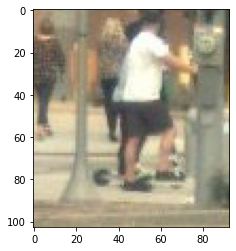

---

Predicted as:  1  | Originally:  0


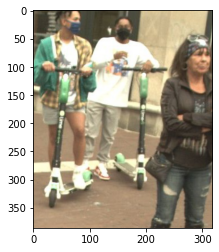

---

Predicted as:  1  | Originally:  0


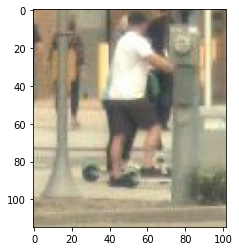

---

Predicted as:  1  | Originally:  0


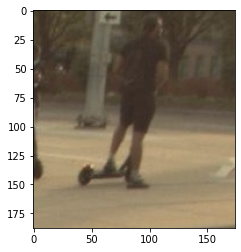

---

Predicted as:  1  | Originally:  0


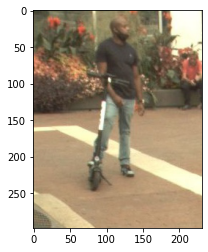

---

Predicted as:  1  | Originally:  0


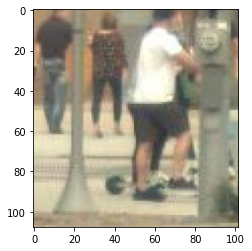

---

Predicted as:  1  | Originally:  0


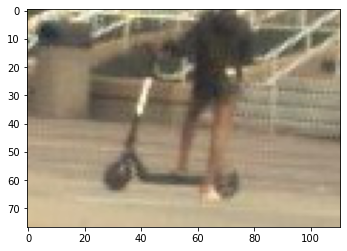

---

Predicted as:  1  | Originally:  0


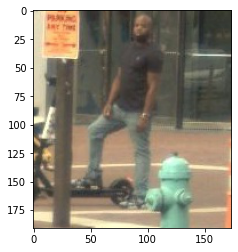

---

Predicted as:  1  | Originally:  0


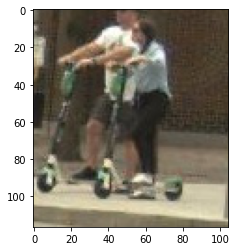

---

Predicted as:  1  | Originally:  0


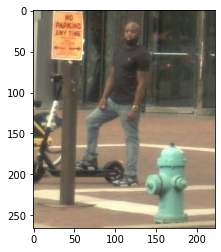

---

Predicted as:  1  | Originally:  0


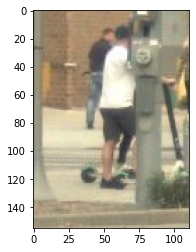

---

Predicted as:  1  | Originally:  0


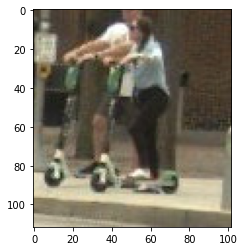

---

Predicted as:  1  | Originally:  0


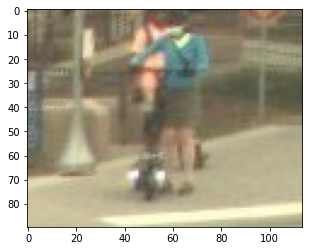

---

Predicted as:  1  | Originally:  0


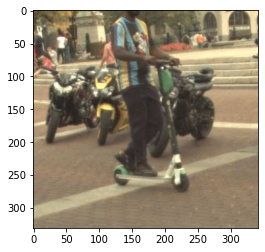

---

Predicted as:  1  | Originally:  0


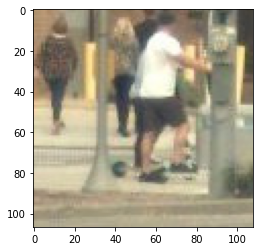

---

Predicted as:  1  | Originally:  0


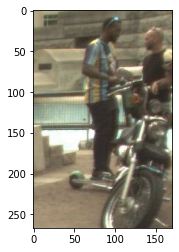

---

Predicted as:  1  | Originally:  0


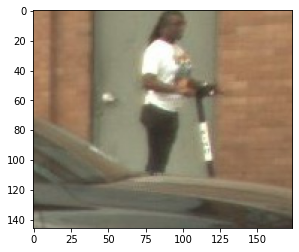

---

Predicted as:  1  | Originally:  0


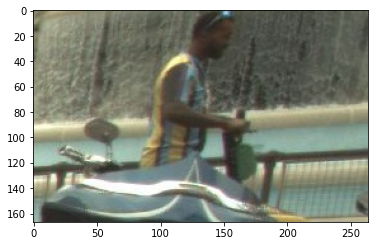

---

Predicted as:  1  | Originally:  0


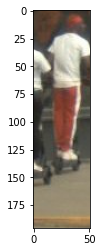

---

Predicted as:  1  | Originally:  0


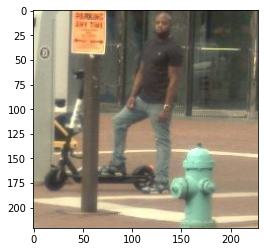

---

Predicted as:  1  | Originally:  0


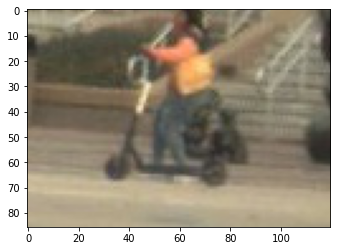

---

Predicted as:  1  | Originally:  0


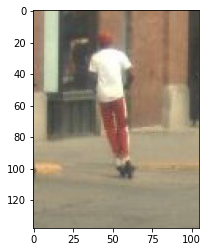

---

Predicted as:  1  | Originally:  0


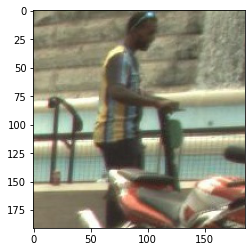

---

Predicted as:  1  | Originally:  0


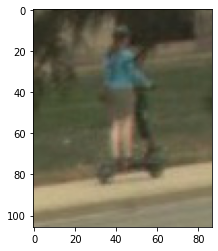

---

Predicted as:  1  | Originally:  0


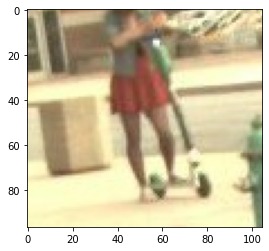

---

Predicted as:  1  | Originally:  0


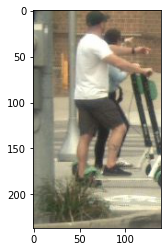

---

Predicted as:  1  | Originally:  0


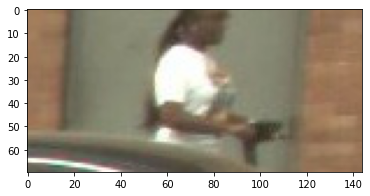

---

Predicted as:  1  | Originally:  0


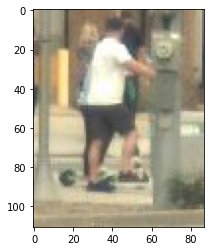

---

Predicted as:  1  | Originally:  0


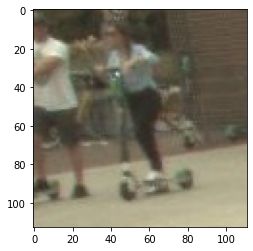

---

Predicted as:  1  | Originally:  0


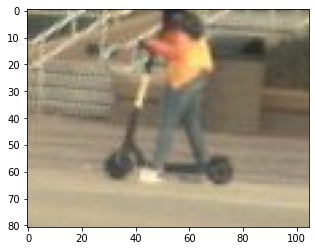

---

Predicted as:  1  | Originally:  0


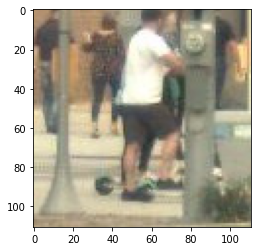

---

Predicted as:  1  | Originally:  0


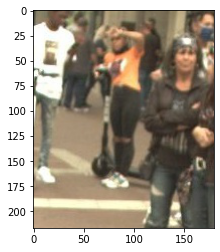

---

Predicted as:  1  | Originally:  0


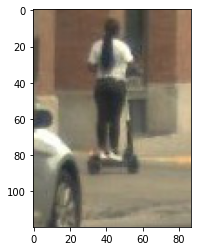

---

Predicted as:  1  | Originally:  0


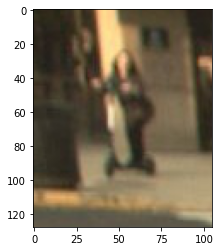

---

Predicted as:  1  | Originally:  0


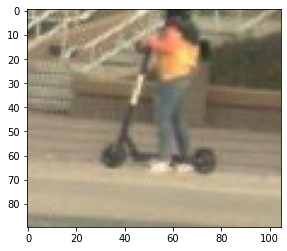

---

Predicted as:  1  | Originally:  0


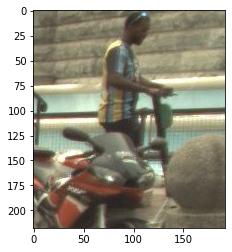

---

Predicted as:  1  | Originally:  0


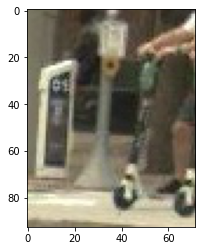

---

Predicted as:  1  | Originally:  0


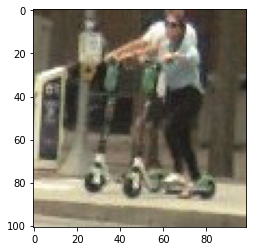

---

Predicted as:  1  | Originally:  0


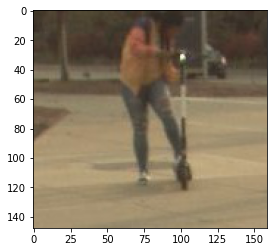

---

Predicted as:  1  | Originally:  0


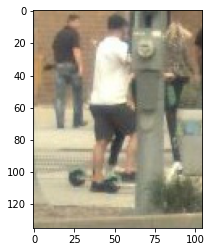

---

Predicted as:  1  | Originally:  0


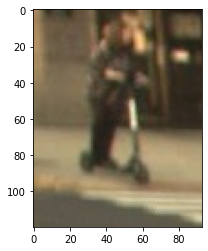

---

Predicted as:  1  | Originally:  0


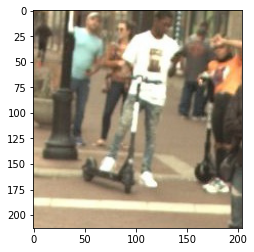

---

Predicted as:  1  | Originally:  0


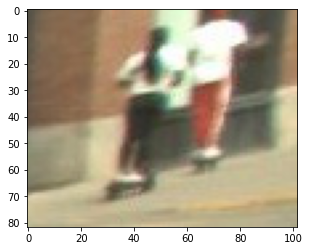

---

Predicted as:  1  | Originally:  0


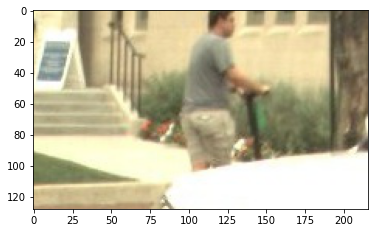

---

Predicted as:  1  | Originally:  0


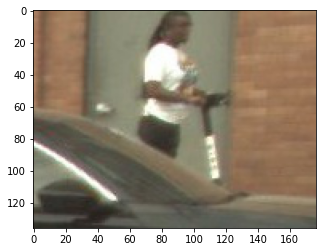

---

Predicted as:  1  | Originally:  0


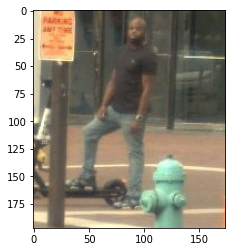

---

Predicted as:  1  | Originally:  0


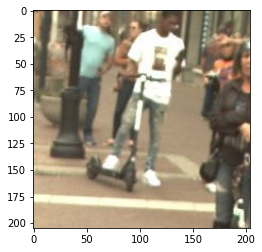

---

Predicted as:  1  | Originally:  0


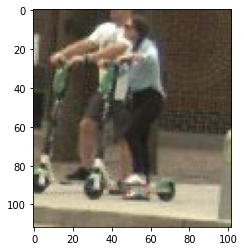

---

Predicted as:  1  | Originally:  0


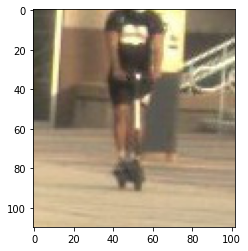

---

Predicted as:  1  | Originally:  0


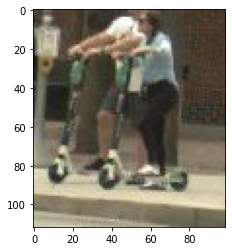

---

Predicted as:  1  | Originally:  0


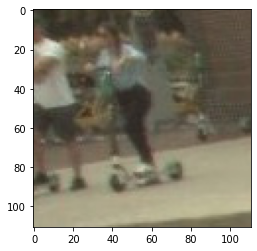

---

Predicted as:  1  | Originally:  0


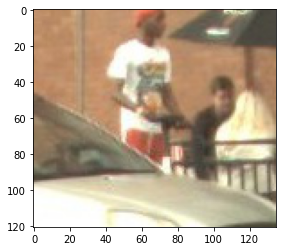

---

Predicted as:  1  | Originally:  0


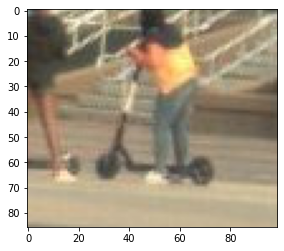

---

Predicted as:  1  | Originally:  0


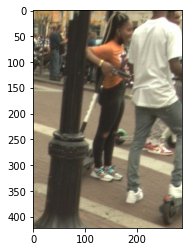

---

Predicted as:  1  | Originally:  0


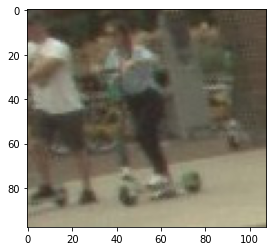

---

Predicted as:  1  | Originally:  0


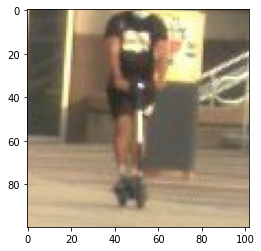

---

Predicted as:  1  | Originally:  0


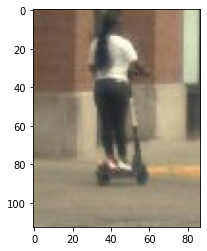

---

Predicted as:  1  | Originally:  0


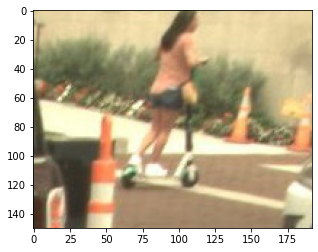

---

Predicted as:  1  | Originally:  0


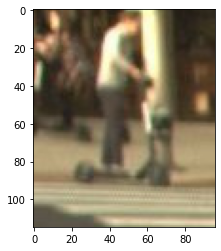

---

Predicted as:  1  | Originally:  0


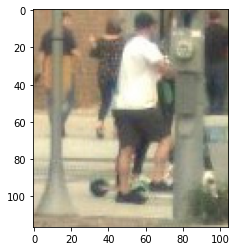

---

Predicted as:  1  | Originally:  0


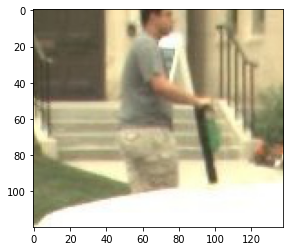

---

Predicted as:  1  | Originally:  0


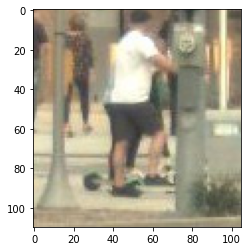

---

Predicted as:  1  | Originally:  0


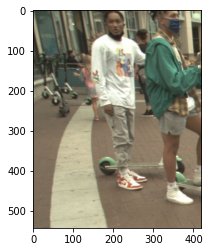

---

Predicted as:  1  | Originally:  0


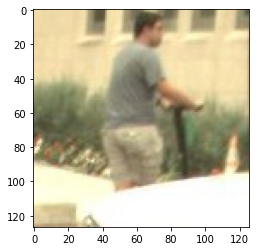

---

Predicted as:  1  | Originally:  0


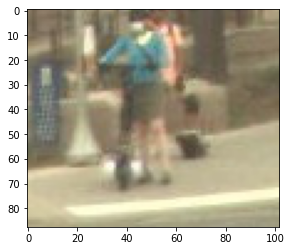

---

Predicted as:  1  | Originally:  0


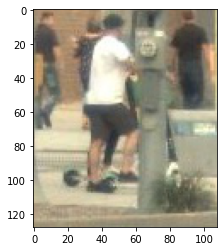

---

Predicted as:  1  | Originally:  0


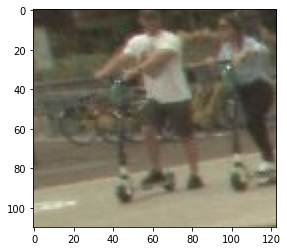

---

Predicted as:  1  | Originally:  0


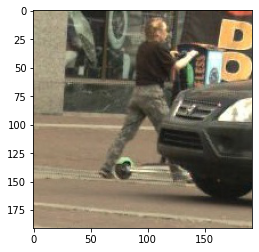

---

Predicted as:  1  | Originally:  0


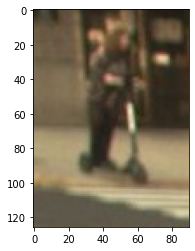

---

Predicted as:  1  | Originally:  0


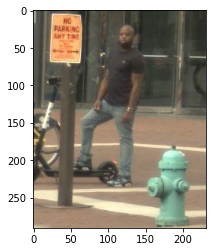

---

Predicted as:  1  | Originally:  0


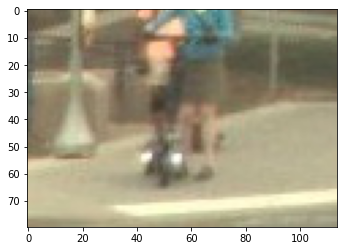

---

Predicted as:  1  | Originally:  0


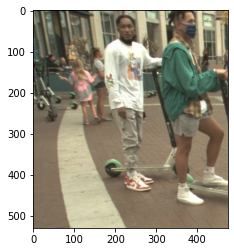

---

Predicted as:  1  | Originally:  0


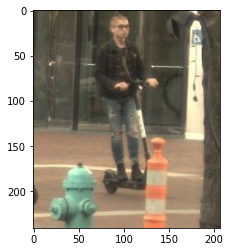

---

Predicted as:  1  | Originally:  0


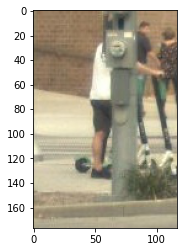

---

Predicted as:  1  | Originally:  0


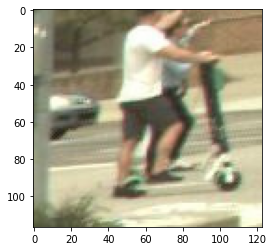

---

Predicted as:  1  | Originally:  0


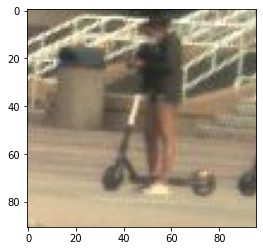

---

Predicted as:  1  | Originally:  0


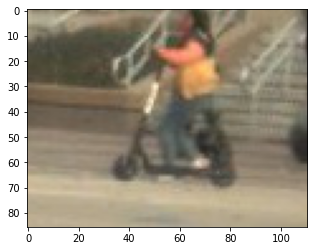

---

Predicted as:  1  | Originally:  0


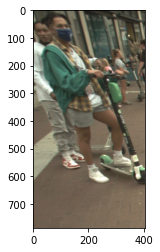

---

Predicted as:  1  | Originally:  0


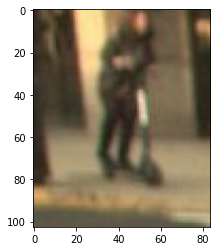

---

Predicted as:  1  | Originally:  0


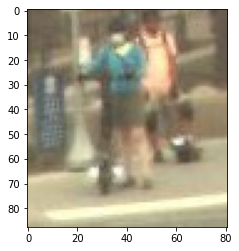

---

Predicted as:  1  | Originally:  0


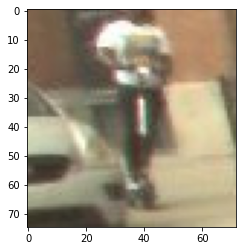

---

Predicted as:  1  | Originally:  0


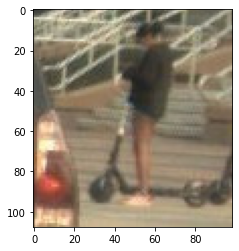

---

Predicted as:  1  | Originally:  0


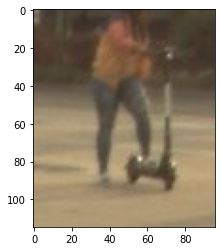

---

Predicted as:  1  | Originally:  0


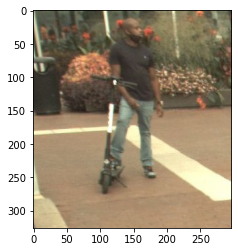

---

Predicted as:  1  | Originally:  0


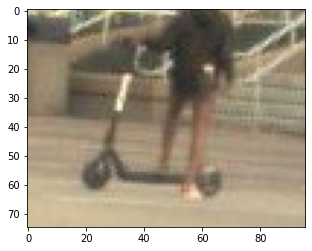

---

Predicted as:  1  | Originally:  0


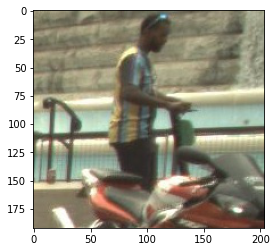

---

Predicted as:  1  | Originally:  0


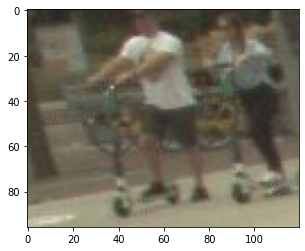

---

Predicted as:  1  | Originally:  0


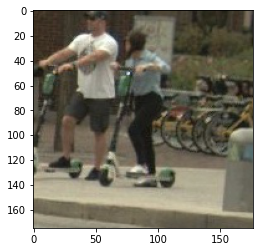

---

Predicted as:  1  | Originally:  0


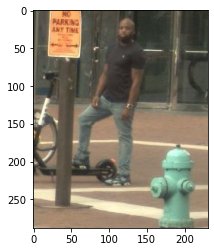

---

Predicted as:  1  | Originally:  0


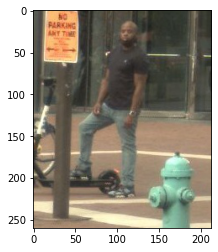

---

Predicted as:  1  | Originally:  0


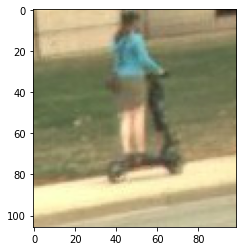

---

Predicted as:  1  | Originally:  0


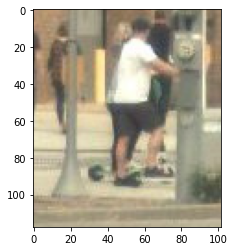

---

Predicted as:  1  | Originally:  0


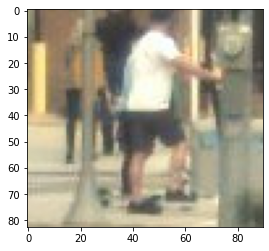

---

Predicted as:  1  | Originally:  0


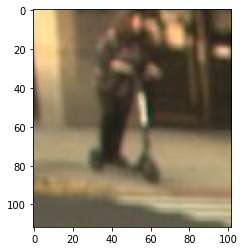

---

Predicted as:  1  | Originally:  0


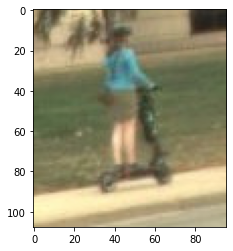

---

Predicted as:  1  | Originally:  0


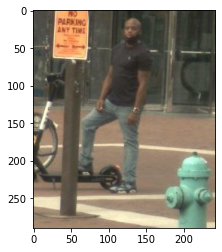

---

Predicted as:  1  | Originally:  0


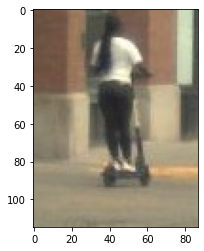

---

Predicted as:  1  | Originally:  0


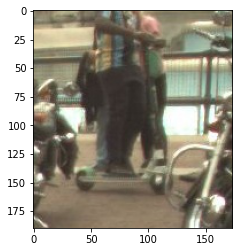

---

Predicted as:  1  | Originally:  0


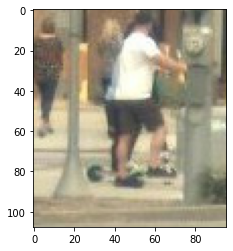

---

Predicted as:  1  | Originally:  0


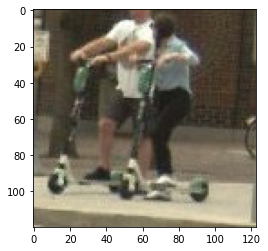

---

Predicted as:  1  | Originally:  0


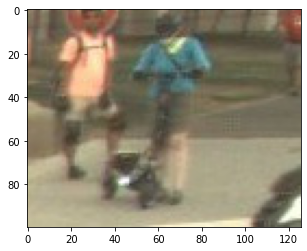

---

Predicted as:  1  | Originally:  0


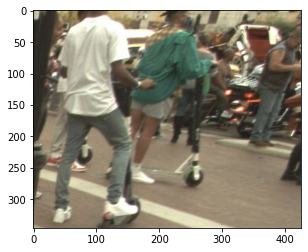

---

Predicted as:  1  | Originally:  0


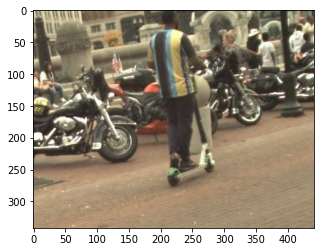

---

Predicted as:  1  | Originally:  0


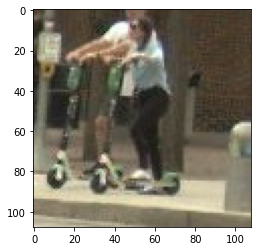

---

Predicted as:  1  | Originally:  0


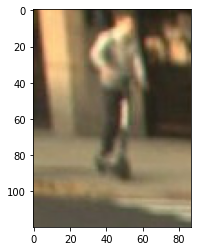

---

Predicted as:  1  | Originally:  0


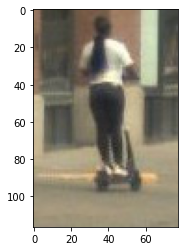

---

Predicted as:  1  | Originally:  0


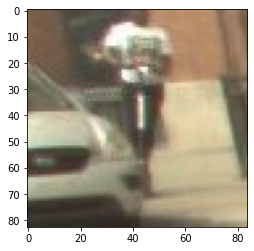

---

Predicted as:  1  | Originally:  0


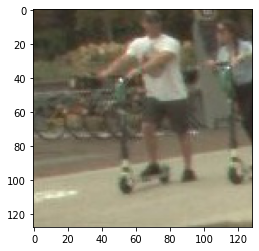

---

Predicted as:  1  | Originally:  0


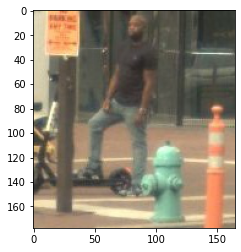

---

Predicted as:  1  | Originally:  0


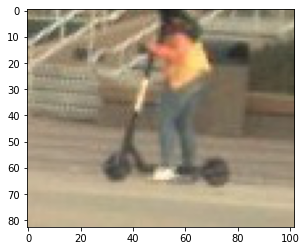

---

Predicted as:  1  | Originally:  0


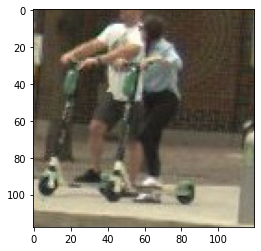

---

Predicted as:  1  | Originally:  0


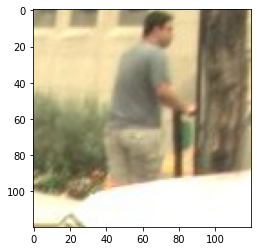

---

Predicted as:  1  | Originally:  0


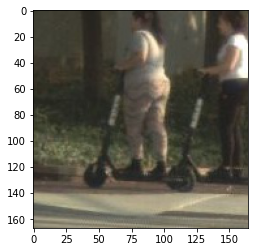

---

Predicted as:  1  | Originally:  0


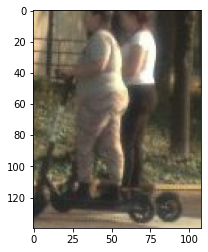

---

Predicted as:  1  | Originally:  0


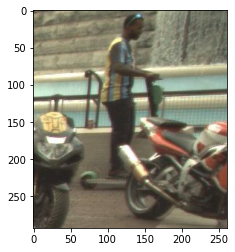

---

Predicted as:  1  | Originally:  0


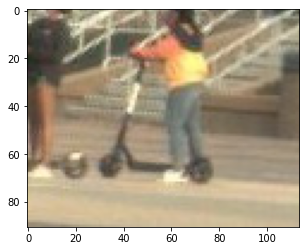

---

Predicted as:  1  | Originally:  0


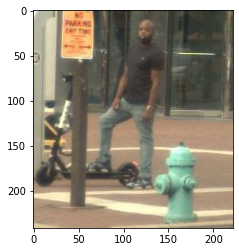

---

Predicted as:  1  | Originally:  0


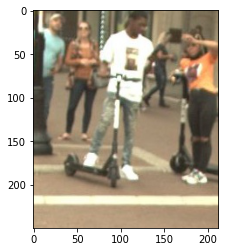

---

Predicted as:  1  | Originally:  0


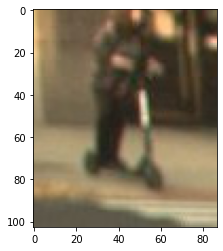

---

Predicted as:  1  | Originally:  0


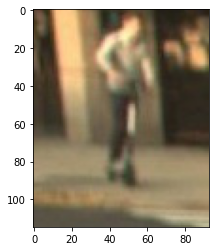

---

Predicted as:  1  | Originally:  0


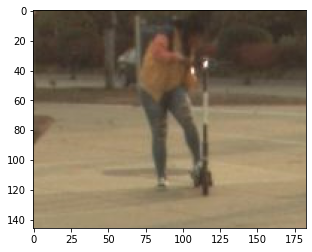

---

Predicted as:  1  | Originally:  0


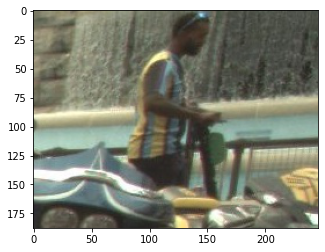

---

Predicted as:  1  | Originally:  0


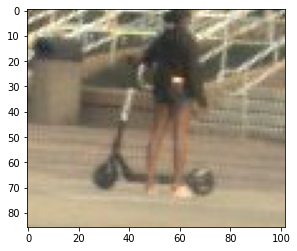

---

Predicted as:  1  | Originally:  0


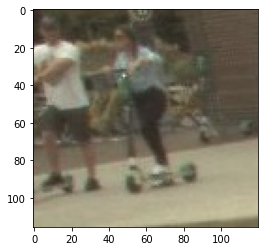

---

Predicted as:  1  | Originally:  0


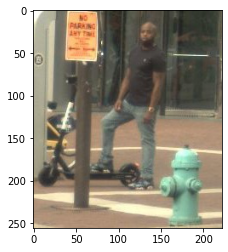

---

Predicted as:  1  | Originally:  0


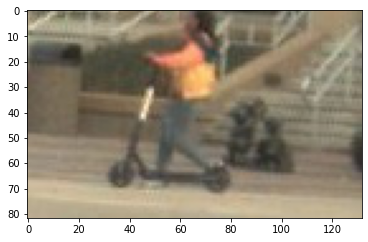

---

Predicted as:  1  | Originally:  0


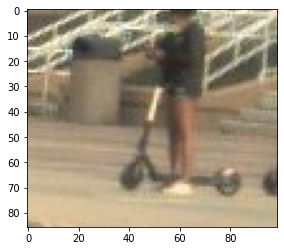

---

Predicted as:  1  | Originally:  0


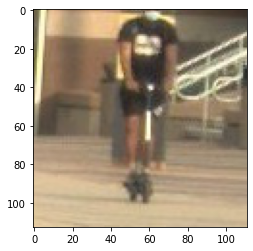

---

Predicted as:  1  | Originally:  0


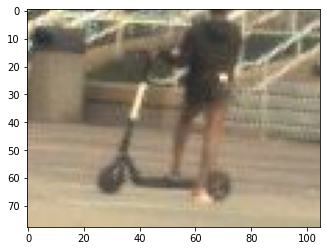

---

Predicted as:  1  | Originally:  0


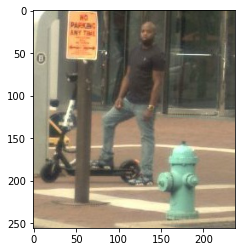

---

Predicted as:  1  | Originally:  0


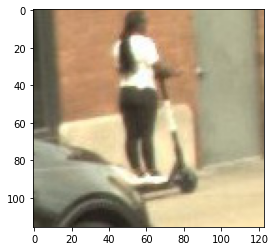

---

Predicted as:  1  | Originally:  0


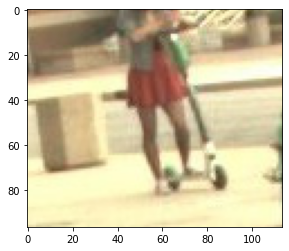

---

Predicted as:  1  | Originally:  0


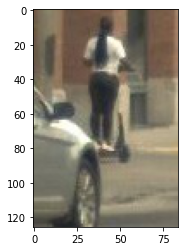

---

Predicted as:  1  | Originally:  0


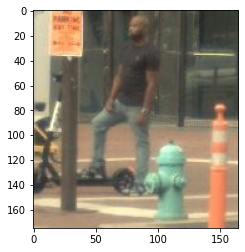

---

Predicted as:  1  | Originally:  0


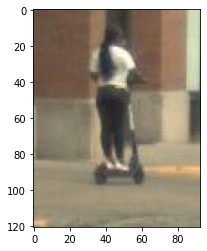

---

Predicted as:  1  | Originally:  0


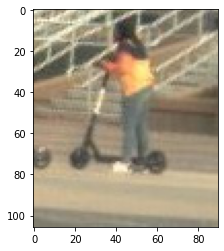

---

Predicted as:  1  | Originally:  0


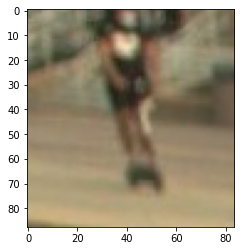

---

Predicted as:  1  | Originally:  0


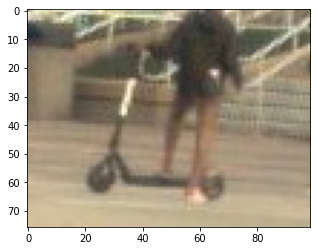

---

Predicted as:  1  | Originally:  0


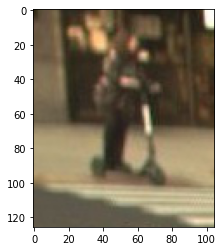

---

Predicted as:  1  | Originally:  0


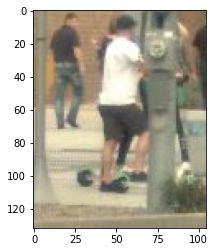

---

Predicted as:  1  | Originally:  0


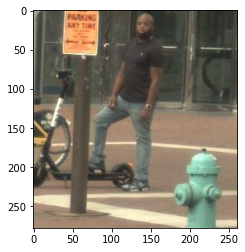

---

Predicted as:  1  | Originally:  0


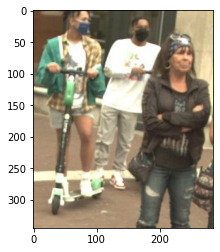

---

Predicted as:  1  | Originally:  0


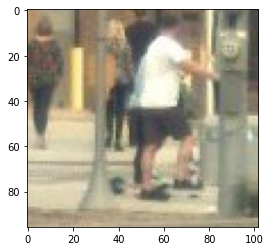

---

Predicted as:  1  | Originally:  0


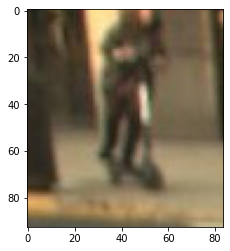

---

Predicted as:  1  | Originally:  0


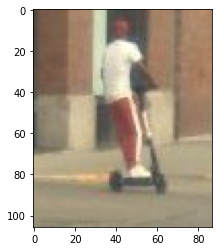

---

Predicted as:  1  | Originally:  0


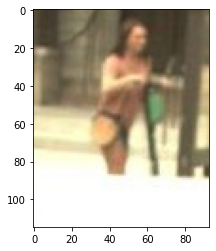

---

Predicted as:  1  | Originally:  0


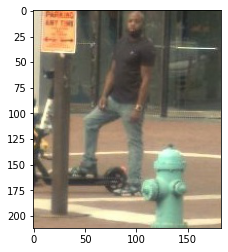

---

Predicted as:  1  | Originally:  0


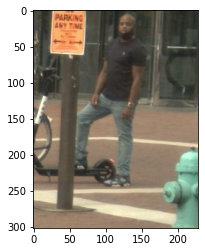

---

Predicted as:  1  | Originally:  0


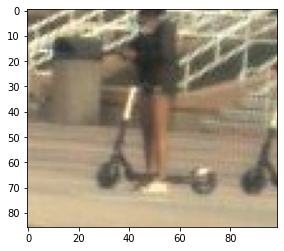

---

Predicted as:  1  | Originally:  0


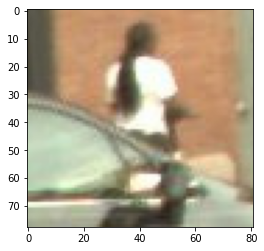

---

Predicted as:  1  | Originally:  0


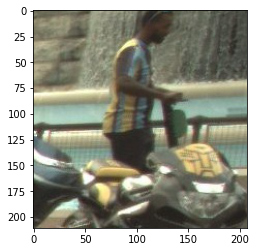

---

Predicted as:  1  | Originally:  0


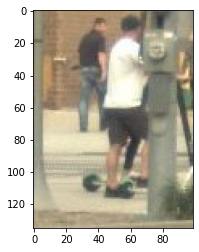

---

Predicted as:  1  | Originally:  0


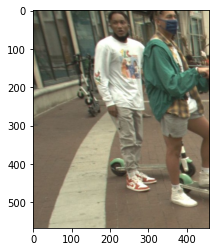

---

Predicted as:  1  | Originally:  0


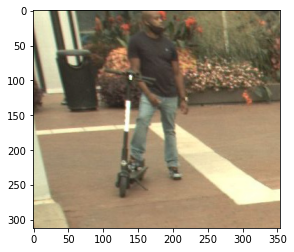

---

Predicted as:  1  | Originally:  0


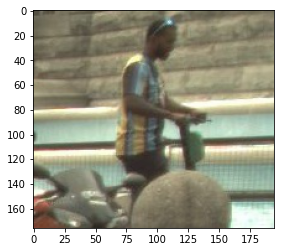

---

Predicted as:  1  | Originally:  0


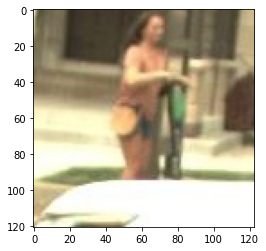

---

Predicted as:  1  | Originally:  0


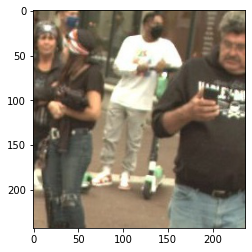

---

Predicted as:  1  | Originally:  0


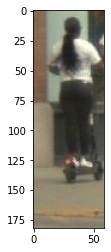

---



In [ ]:
count = 0
conf = 0.6 #60%
wrong_preds_dir = "/content/gdrive/My Drive/thesis/wrong_preds/"

for dir in os.listdir(test_path):
  path = os.path.join(test_path, dir)
  if dir == 'esc': label = 0
  else: label = 1

  filenames = os.listdir(path)
  for i in range(len(filenames)):
    fname = os.path.join(path, filenames[i])
    frame = cv2.imread(fname)

    if dir == 'no_esc': index = i
    else: index = i+1228
    pred = prediction_scores[index]
    
    if pred < 0.6:
      pred = 0
    else: pred = 1

    if pred != label:
      count += 1 
      print('Predicted as: ', pred, ' | Originally: ', label)
      img = mpimg.imread(fname)
      imgplot = plt.imshow(img)
      plt.show()
      print('---\n')
      cv2.imwrite(os.path.join(wrong_preds_dir, filenames[i]), frame)

In [ ]:
count

233

In [ ]:
conf = 0.20
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
draw_ROC(original_labels, predictions)


Confusion Matrix
[[1160  109]
 [ 143 1085]]

Classification Report
              precision    recall  f1-score   support

         esc       0.89      0.91      0.90      1269
      no-esc       0.91      0.88      0.90      1228

    accuracy                           0.90      2497
   macro avg       0.90      0.90      0.90      2497
weighted avg       0.90      0.90      0.90      2497

ROC-AUC Score:  0.8988280417780037


In [ ]:
conf = 0.30
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
draw_ROC(original_labels, predictions)


Confusion Matrix
[[1132  137]
 [ 100 1128]]

Classification Report
              precision    recall  f1-score   support

         esc       0.92      0.89      0.91      1269
      no-esc       0.89      0.92      0.90      1228

    accuracy                           0.91      2497
   macro avg       0.91      0.91      0.91      2497
weighted avg       0.91      0.91      0.91      2497

ROC-AUC Score:  0.9053038761958299



Confusion Matrix
[[1107  162]
 [  71 1157]]

Classification Report
              precision    recall  f1-score   support

         esc       0.94      0.87      0.90      1269
      no-esc       0.88      0.94      0.91      1228

    accuracy                           0.91      2497
   macro avg       0.91      0.91      0.91      2497
weighted avg       0.91      0.91      0.91      2497

0.9072614179776839


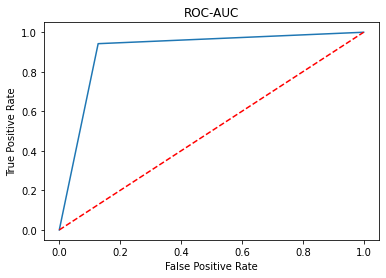

In [ ]:
conf = 0.40
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
draw_ROC(original_labels, predictions)


Confusion Matrix
[[1135  134]
 [ 271  957]]

Classification Report
              precision    recall  f1-score   support

         esc       0.81      0.89      0.85      1269
      no-esc       0.88      0.78      0.83      1228

    accuracy                           0.84      2497
   macro avg       0.84      0.84      0.84      2497
weighted avg       0.84      0.84      0.84      2497

ROC-AUC Score:  0.8368605021266328


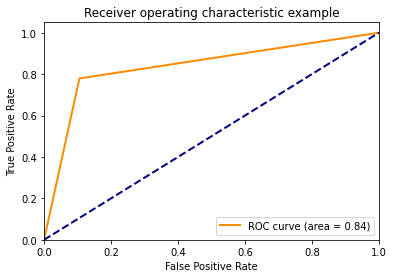

In [ ]:
conf = 0.50
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
draw_ROC(original_labels, predictions)

ROC-AUC Score:  0.9618056357695279


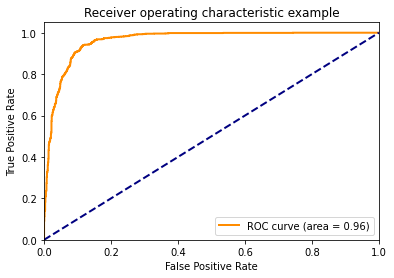

In [ ]:
conf = 0.50
predictions = get_preds(conf)
# get_model_metrics(original_labels, prediction_scores)
draw_ROC(original_labels, prediction_scores)

In [ ]:
conf = 0.60
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
draw_ROC(original_labels, predictions)


Confusion Matrix
[[1053  216]
 [  39 1189]]

Classification Report
              precision    recall  f1-score   support

         esc       0.96      0.83      0.89      1269
      no-esc       0.85      0.97      0.90      1228

    accuracy                           0.90      2497
   macro avg       0.91      0.90      0.90      2497
weighted avg       0.91      0.90      0.90      2497

ROC-AUC Score:  0.8990141381939151


In [ ]:
conf = 0.70
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
# draw_ROC(original_labels, predictions)


Confusion Matrix
[[1105  164]
 [  66 1162]]

Classification Report
              precision    recall  f1-score   support

         esc       0.94      0.87      0.91      1269
      no-esc       0.88      0.95      0.91      1228

    accuracy                           0.91      2497
   macro avg       0.91      0.91      0.91      2497
weighted avg       0.91      0.91      0.91      2497



In [ ]:
conf = 0.80
predictions = get_preds(conf)
get_model_metrics(original_labels, predictions)
# draw_ROC(original_labels, predictions)


Confusion Matrix
[[1088  181]
 [  56 1172]]

Classification Report
              precision    recall  f1-score   support

         esc       0.95      0.86      0.90      1269
      no-esc       0.87      0.95      0.91      1228

    accuracy                           0.91      2497
   macro avg       0.91      0.91      0.90      2497
weighted avg       0.91      0.91      0.90      2497



Visualizing false detections